## Modified DCGAN

* This is a modified version of the DCGAN described [in this link](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html).

* The original implementation is for an image size of 64 x 64. So, to use it for other resolutions, we need to manually adjust the generator and discriminator networks.

* This modified implementation removes manual adjustment. It automatically adjusts the generator and discriminator networks based on the image resolution. In addition, it finds the proper kernel size automatically.


In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from copy import deepcopy

In [2]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


#### Initialize parameters and hyperparameters

In [3]:
#%%
# Root directory for dataset
dataroot = r"F:\Research\wound tissue segmentation\dataset_azh"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 20

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

#### Prepare dataset

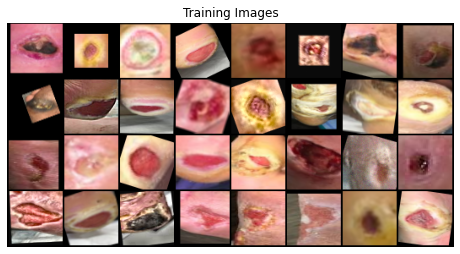

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

#### Helper function

In [5]:
#%% Helper function: Find no. of stages for the GAN model
def stage(number, ignore_2:bool=True):
    """ Find no. of stages and quotients for the GAN model
    Inputs
    ---------
    number: (int) An integer number indicating the height or width of the image,
        considering square-shaped image
    ignore_2: (bool) If true, then ignores that stage where the quotient is 2
        For instance, for number=128, if ignore_2 is True, then - 
        quotients = [64, 32, 16, 8, 4], otherwise - 
        quotients = [64, 32, 16, 8, 4, 2]
        
    
    Outputs
    ---------
    quotients: (list) List of quotients of the GAN model
    len(channels):  No. of stages of the GAN model
    result: (int) kernel size
    """
    
    
    quotients = []
    
    while(True):
        result = number // 2      
        
        quotients.append(result) # store the result
        
        # Stopping criteria
        if ignore_2: # If the result is a odd number of 4, then break the loop
            if result % 2 == 1 or result == 4: break
        else: # If the result is a odd number of 2, then break the loop
            if result % 2 == 1 or result == 2: break
        
        # Update number        
        number = result
    
    return quotients, len(quotients), result

# print(stage(256))


#===============================================================================
#%% Helper function: save a model

def save(model_path, epoch, model_state_dict, optimizer_state_dict):
    
    state = {
        'epoch': epoch + 1,
        'state_dict': deepcopy(model_state_dict),
        'optimizer': deepcopy(optimizer_state_dict),
        }
    
    torch.save(state, model_path)

#### Weight initialization

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

#### Create generator 

In [7]:
# Call helper function -> stage
_, N_STAGES, KERNEL_SIZE = stage(image_size, ignore_2=True)

Create generator layers

In [8]:
def gen_layers(im_size, nz, ngf, nc):
    
    layers = []
    
    in_ch = nz # initial no. of input channels
    
    # Create layers for each stage except for the final stage
    for i in range(N_STAGES)[::-1]: # descending order
    
        out_ch = ngf * 2**i # no. of output channels
        
        # First stage has different configuration than other stages
        if i == N_STAGES - 1: layers.append(nn.ConvTranspose2d(in_ch, out_ch, KERNEL_SIZE, 1, 0, bias=False))
        else: layers.append(nn.ConvTranspose2d(in_ch, out_ch, KERNEL_SIZE, 2, 1, bias=False))
        
        layers.append(nn.BatchNorm2d(out_ch))
        layers.append(nn.ReLU(True))
        
        in_ch = out_ch # update no. of input channels
    
    # Create layers for the final stage
    layers.append(nn.ConvTranspose2d(ngf, nc, KERNEL_SIZE, 2, 1, bias=False))
    layers.append(nn.Tanh())
    
    return nn.Sequential(*layers) # list to nn.Sequential

Create generator class

In [9]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = gen_layers(image_size, nz, ngf, nc)
        
    def forward(self, input):
        return self.main(input)

Create generator object

In [10]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


Test generator

In [11]:
v = torch.randn(1, 100, 1, 1, device=device)
gen_out = netG(v)

print(gen_out.size())

torch.Size([1, 3, 64, 64])


#### Create discriminator

Create discriminator layers

In [12]:
def disc_layers(im_size, ndf, nc):
    
    layers = []
    
    in_ch = nc # initial no. of input channels
    
    # Create layers for each stage except for the final stage
    for i in range(N_STAGES): # ascending order
    
        out_ch = ndf * 2**i # no. of output channels
        
        layers.append(nn.Conv2d(in_ch, out_ch, KERNEL_SIZE, 2, 1, bias=False))
        if i != 0: layers.append(nn.BatchNorm2d(out_ch)) # In first stage, there is no batch normalization
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        
        in_ch = out_ch # update no. of input channels
    
    # Create layers for the final stage
    layers.append(nn.Conv2d(in_ch, 1, KERNEL_SIZE, 1, 0, bias=False))
    layers.append(nn.Sigmoid())
    
    return nn.Sequential(*layers) # list to nn.Sequential

Create discriminator class

In [13]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = disc_layers(image_size, ndf, nc)
        
    def forward(self, input):
        return self.main(input)

Create discriminator object

In [14]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


Test discriminator

In [15]:
torch.manual_seed(999)
inp = torch.randn(1, 3, 512, 512)
inp = inp.to(device)

disc_out = netD(inp)

print(disc_out.size())

torch.Size([1, 1, 29, 29])


#### Loss function and optimizer

In [16]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

#### Create checkpoint directory

In [18]:
#%% Set checkpoint directory
checkpoint_loc = r'F:\Research\wound tissue segmentation\checkpoints\size64'
if not os.path.exists(checkpoint_loc): os.makedirs(checkpoint_loc)

#### Training

In [19]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
best_D_G_z2 = 0 # model having best D_G_z2 score will be stored

print("Starting Training Loop...")

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    iter_D_G_z2 = [] # stores D_G_z2 for each iteration
    
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # only images, not labels
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        iter_D_G_z2.append(D_G_z2)

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
    avg_D_G_z2 = np.mean(iter_D_G_z2)
    
    # Store best model
    if avg_D_G_z2 > best_D_G_z2:
        print(f'Average D_G_z2 improved. Saving the model at epoch: {epoch:04d} and iteration: {i:04d}')
        save(os.path.join(checkpoint_loc, 'best_model' + '.pth'), epoch+1, netG.state_dict(), optimizerG.state_dict())            
        best_D_G_z2 = D_G_z2

Starting Training Loop...
[0/20][0/782]	Loss_D: 1.4981	Loss_G: 5.9813	D(x): 0.5246	D(G(z)): 0.4764 / 0.0031
[0/20][50/782]	Loss_D: 0.0237	Loss_G: 8.7556	D(x): 0.9777	D(G(z)): 0.0004 / 0.0003
[0/20][100/782]	Loss_D: 0.0001	Loss_G: 39.3221	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][150/782]	Loss_D: 0.0001	Loss_G: 39.1651	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][200/782]	Loss_D: 0.0004	Loss_G: 39.0479	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000
[0/20][250/782]	Loss_D: 0.0001	Loss_G: 38.9308	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][300/782]	Loss_D: 0.0001	Loss_G: 38.8110	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][350/782]	Loss_D: 0.0001	Loss_G: 38.8340	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][400/782]	Loss_D: 0.0001	Loss_G: 38.6978	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][450/782]	Loss_D: 0.0002	Loss_G: 38.4800	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000
[0/20][500/782]	Loss_D: 0.0001	Loss_G: 38.4607	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[0/20][550/782]	Loss_D: 0.0000	Loss_G: 38.10

[6/20][0/782]	Loss_D: 0.5747	Loss_G: 4.2866	D(x): 0.9703	D(G(z)): 0.3473 / 0.0196
[6/20][50/782]	Loss_D: 0.5721	Loss_G: 1.3581	D(x): 0.6999	D(G(z)): 0.0960 / 0.3345
[6/20][100/782]	Loss_D: 1.0927	Loss_G: 6.8792	D(x): 0.9907	D(G(z)): 0.5692 / 0.0055
[6/20][150/782]	Loss_D: 0.1498	Loss_G: 4.1890	D(x): 0.9712	D(G(z)): 0.1048 / 0.0310
[6/20][200/782]	Loss_D: 0.2219	Loss_G: 4.8899	D(x): 0.8946	D(G(z)): 0.0708 / 0.0201
[6/20][250/782]	Loss_D: 0.4994	Loss_G: 3.0929	D(x): 0.7802	D(G(z)): 0.1461 / 0.0853
[6/20][300/782]	Loss_D: 0.4249	Loss_G: 3.9599	D(x): 0.7379	D(G(z)): 0.0568 / 0.0544
[6/20][350/782]	Loss_D: 1.0248	Loss_G: 7.0908	D(x): 0.8479	D(G(z)): 0.4685 / 0.0044
[6/20][400/782]	Loss_D: 0.1096	Loss_G: 4.0824	D(x): 0.9259	D(G(z)): 0.0297 / 0.0260
[6/20][450/782]	Loss_D: 0.3227	Loss_G: 4.0605	D(x): 0.9412	D(G(z)): 0.2063 / 0.0267
[6/20][500/782]	Loss_D: 0.1916	Loss_G: 4.0127	D(x): 0.9171	D(G(z)): 0.0651 / 0.0342
[6/20][550/782]	Loss_D: 0.5963	Loss_G: 5.9705	D(x): 0.9720	D(G(z)): 0.3596 / 0.

[12/20][100/782]	Loss_D: 0.3416	Loss_G: 5.0299	D(x): 0.9944	D(G(z)): 0.2416 / 0.0172
[12/20][150/782]	Loss_D: 0.7940	Loss_G: 4.5970	D(x): 0.8399	D(G(z)): 0.4093 / 0.0169
[12/20][200/782]	Loss_D: 0.1444	Loss_G: 3.8283	D(x): 0.9738	D(G(z)): 0.1037 / 0.0468
[12/20][250/782]	Loss_D: 0.2596	Loss_G: 4.0625	D(x): 0.8243	D(G(z)): 0.0509 / 0.0451
[12/20][300/782]	Loss_D: 0.2629	Loss_G: 3.2512	D(x): 0.8516	D(G(z)): 0.0521 / 0.0563
[12/20][350/782]	Loss_D: 1.3216	Loss_G: 1.2657	D(x): 0.4458	D(G(z)): 0.0977 / 0.4400
[12/20][400/782]	Loss_D: 0.1165	Loss_G: 3.6865	D(x): 0.9884	D(G(z)): 0.0928 / 0.0363
[12/20][450/782]	Loss_D: 0.6798	Loss_G: 2.2347	D(x): 0.6600	D(G(z)): 0.1330 / 0.1760
[12/20][500/782]	Loss_D: 0.6007	Loss_G: 3.8715	D(x): 0.7869	D(G(z)): 0.2134 / 0.0493
[12/20][550/782]	Loss_D: 0.2194	Loss_G: 4.8866	D(x): 0.9771	D(G(z)): 0.1510 / 0.0114
[12/20][600/782]	Loss_D: 0.1615	Loss_G: 4.7753	D(x): 0.9981	D(G(z)): 0.1348 / 0.0204
[12/20][650/782]	Loss_D: 0.2233	Loss_G: 4.4575	D(x): 0.9824	D(G(z

[18/20][150/782]	Loss_D: 0.2464	Loss_G: 4.0842	D(x): 0.9857	D(G(z)): 0.1917 / 0.0229
[18/20][200/782]	Loss_D: 0.1545	Loss_G: 7.0057	D(x): 0.8811	D(G(z)): 0.0140 / 0.0039
[18/20][250/782]	Loss_D: 0.2186	Loss_G: 4.7706	D(x): 0.9958	D(G(z)): 0.1708 / 0.0167
[18/20][300/782]	Loss_D: 0.3220	Loss_G: 5.0866	D(x): 0.8332	D(G(z)): 0.0512 / 0.0498
[18/20][350/782]	Loss_D: 0.7008	Loss_G: 4.6037	D(x): 0.9897	D(G(z)): 0.4497 / 0.0211
[18/20][400/782]	Loss_D: 0.2592	Loss_G: 4.4147	D(x): 0.9691	D(G(z)): 0.1857 / 0.0173
[18/20][450/782]	Loss_D: 0.1080	Loss_G: 4.4977	D(x): 0.9371	D(G(z)): 0.0370 / 0.0236
[18/20][500/782]	Loss_D: 0.0674	Loss_G: 5.6351	D(x): 0.9496	D(G(z)): 0.0134 / 0.0057
[18/20][550/782]	Loss_D: 0.3898	Loss_G: 4.5056	D(x): 0.8330	D(G(z)): 0.0857 / 0.0270
[18/20][600/782]	Loss_D: 0.3369	Loss_G: 3.0075	D(x): 0.8036	D(G(z)): 0.0248 / 0.0799
[18/20][650/782]	Loss_D: 0.1331	Loss_G: 4.8671	D(x): 0.8911	D(G(z)): 0.0101 / 0.0183
[18/20][700/782]	Loss_D: 0.0262	Loss_G: 5.1970	D(x): 0.9898	D(G(z

In [20]:
save(os.path.join(checkpoint_loc, 'last_model' + '.pth'), epoch+1, netG.state_dict(), optimizerG.state_dict())

#### Plot losses

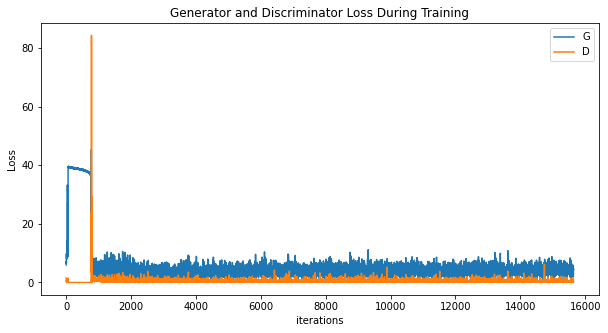

In [21]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

#### Visualization

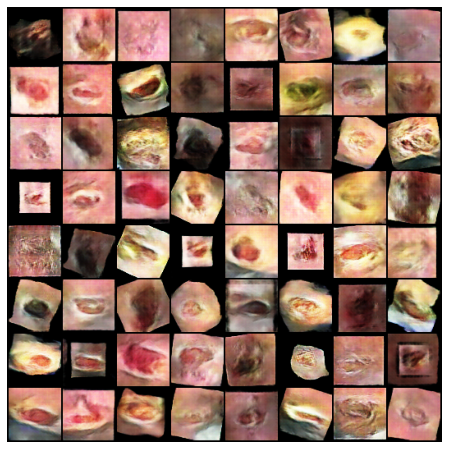

In [22]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

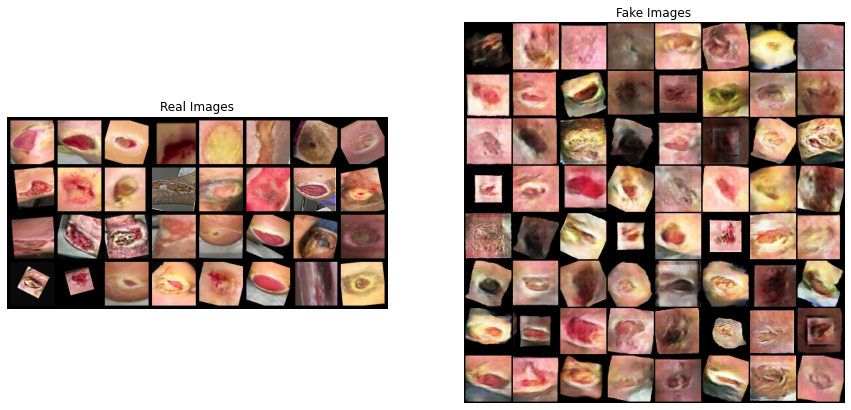

In [23]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

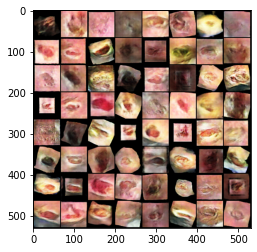

In [24]:
plt.imshow(np.transpose(img_list[-1],(1,2,0)))

In [25]:
len(img_list)

33

In [26]:
x = img_list[1]

In [27]:
x.shape

torch.Size([3, 530, 530])

In [28]:
x2 = np.transpose(x, (1,2,0))

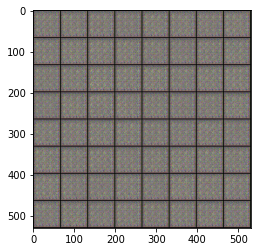

In [29]:
plt.imshow(x2)